Found 110 puzzles.


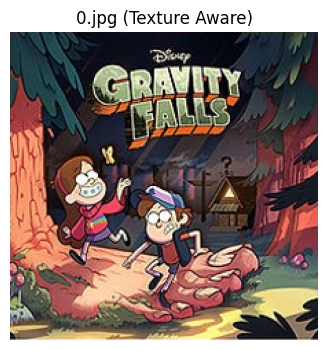

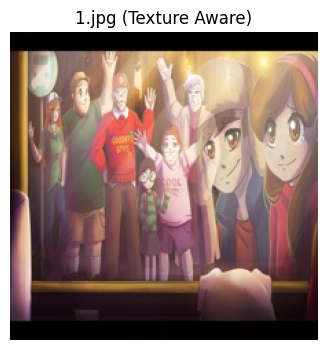

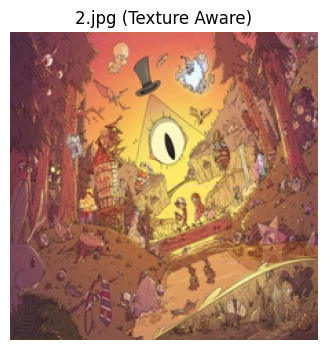

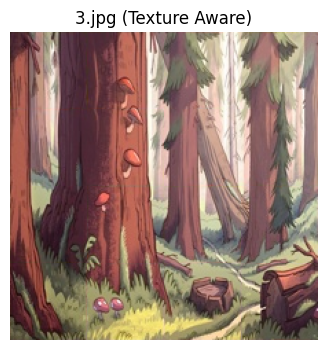

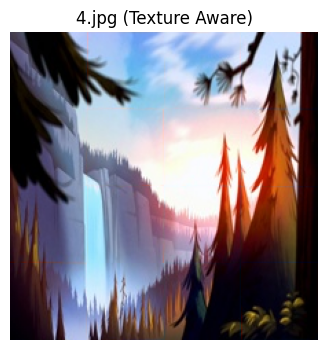

...

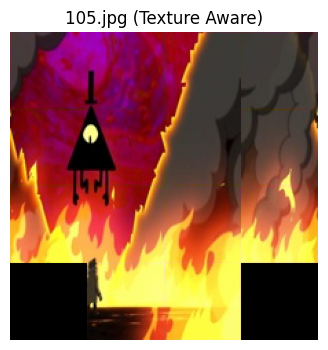

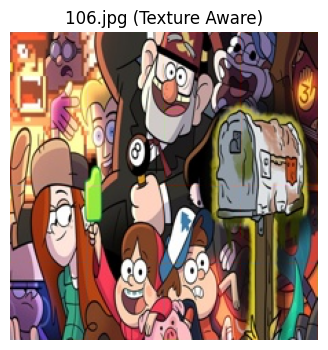

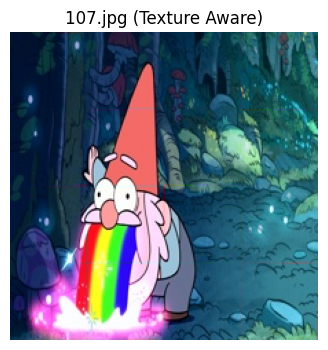

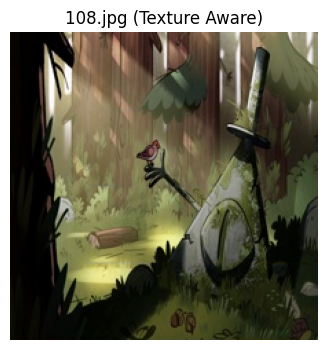

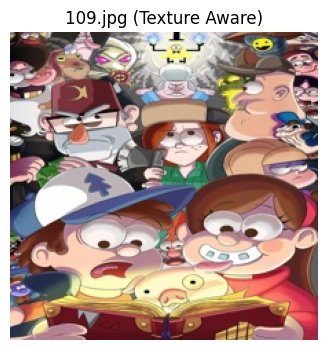

In [12]:
# =========================================================
# 1. SETUP & IMPORTS
# =========================================================
import cv2
import numpy as np
import glob
import os
import matplotlib.pyplot as plt
import random
from google.colab import drive

# Mount Drive
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# PATH SETUP (Update if needed)
base_path = "/content/drive/MyDrive/Gravity Falls/puzzle_4x4/"
GRID_SIZE = 4

# =========================================================
# 2. ENHANCED LOGIC: TEXTURE-AWARE + GAP FILL
# =========================================================

class PuzzleGroup:
    def __init__(self, piece_id):
        self.placements = {(0, 0): piece_id}
        self.min_r, self.max_r = 0, 0
        self.min_c, self.max_c = 0, 0
        self.id = piece_id

    def size(self): return len(self.placements)

    def can_merge(self, other_group, offset_r, offset_c):
        """Checks bounds (4x4) and collisions."""
        new_min_r = min(self.min_r, other_group.min_r + offset_r)
        new_max_r = max(self.max_r, other_group.max_r + offset_r)
        new_min_c = min(self.min_c, other_group.min_c + offset_c)
        new_max_c = max(self.max_c, other_group.max_c + offset_c)

        if (new_max_r - new_min_r + 1) > GRID_SIZE: return False
        if (new_max_c - new_min_c + 1) > GRID_SIZE: return False

        for (r, c) in other_group.placements:
            if (r + offset_r, c + offset_c) in self.placements:
                return False
        return True

    def merge(self, other_group, offset_r, offset_c):
        for (r, c), pid in other_group.placements.items():
            self.placements[(r + offset_r, c + offset_c)] = pid
        self.min_r = min(self.min_r, other_group.min_r + offset_r)
        self.max_r = max(self.max_r, other_group.max_r + offset_r)
        self.min_c = min(self.min_c, other_group.min_c + offset_c)
        self.max_c = max(self.max_c, other_group.max_c + offset_c)

def get_edge_variance(edge_pixels):
    """Calculates visual detail. High Variance = Complex (Face/Line)."""
    gray = np.mean(edge_pixels, axis=1)
    return np.var(gray)

def calculate_smart_edges(lab_pieces):
    """
    Calculates costs but prioritizes High Variance 'Best Buddies'.
    This prevents the solver from getting confused by flat sky/smoke.
    """
    n = len(lab_pieces)

    rights  = np.array([p[:, -1, :] for p in lab_pieces])
    lefts   = np.array([p[:, 0, :] for p in lab_pieces])
    bottoms = np.array([p[-1, :, :] for p in lab_pieces])
    tops    = np.array([p[0, :, :] for p in lab_pieces])

    H_cost = np.zeros((n, n))
    V_cost = np.zeros((n, n))
    H_var = np.zeros(n)
    V_var = np.zeros(n)

    # 1. Calculate Variance (Detail Level)
    for i in range(n):
        H_var[i] = get_edge_variance(rights[i])
        V_var[i] = get_edge_variance(bottoms[i])

    # 2. Calculate Raw Costs
    for i in range(n):
        for j in range(n):
            if i == j:
                H_cost[i,j] = V_cost[i,j] = float('inf')
                continue
            H_cost[i,j] = np.sum((rights[i] - lefts[j])**2)
            V_cost[i,j] = np.sum((bottoms[i] - tops[j])**2)

    # 3. Identify Best Buddies
    def is_buddy(u, v, cost_mat):
        best_fwd = np.argmin(cost_mat[u, :])
        best_bwd = np.argmin(cost_mat[:, v])
        return (best_fwd == v) and (best_bwd == u)

    edges = []

    # 4. Build Priority List
    for u in range(n):
        for v in range(n):
            if u == v: continue

            # Horizontal
            buddy = is_buddy(u, v, H_cost)
            # If Buddy: Start at -10000. Subtract variance to prioritize detail.
            # This ensures we solve faces before walls.
            if buddy: score = -10000 - H_var[u]
            else:     score = H_cost[u, v]
            edges.append((score, u, v, 0)) # 0 = Horizontal

            # Vertical
            buddy = is_buddy(u, v, V_cost)
            if buddy: score = -10000 - V_var[u]
            else:     score = V_cost[u, v]
            edges.append((score, u, v, 1)) # 1 = Vertical

    edges.sort(key=lambda x: x[0])
    return edges, H_cost, V_cost

def solve_texture_aware_4x4(pieces):
    # 1. LAB Conversion
    lab_pieces = [cv2.cvtColor(p, cv2.COLOR_RGB2LAB).astype("float32") for p in pieces]

    # 2. Smart Edges (Texture Weighted)
    sorted_edges, H_cost, V_cost = calculate_smart_edges(lab_pieces)

    groups = {i: PuzzleGroup(i) for i in range(len(pieces))}
    group_lookup = {i: i for i in range(len(pieces))}

    # 3. MERGE PHASE 1: Confident Matches
    for _, u, v, relation in sorted_edges:
        u_gid = group_lookup[u]
        v_gid = group_lookup[v]
        if u_gid == v_gid: continue

        group_u = groups[u_gid]
        group_v = groups[v_gid]

        u_loc = [k for k, val in group_u.placements.items() if val == u][0]
        v_loc = [k for k, val in group_v.placements.items() if val == v][0]

        if relation == 0: # Horizontal
            target_r, target_c = u_loc[0], u_loc[1] + 1
        else: # Vertical
            target_r, target_c = u_loc[0] + 1, u_loc[1]

        offset_r = target_r - v_loc[0]
        offset_c = target_c - v_loc[1]

        if group_u.can_merge(group_v, offset_r, offset_c):
            group_u.merge(group_v, offset_r, offset_c)
            for pid in group_v.placements.values():
                group_lookup[pid] = u_gid
            del groups[v_gid]
            if len(groups) == 1: break

    # 4. MERGE PHASE 2: Force Stitching (Fix Voids)
    # If islands remain, force them together using the best available link
    while len(groups) > 1:
        best_merge_score = float('inf')
        best_merge_action = None

        group_ids = list(groups.keys())
        for i in range(len(group_ids)):
            for j in range(i + 1, len(group_ids)):
                gid1, gid2 = group_ids[i], group_ids[j]
                g1, g2 = groups[gid1], groups[gid2]

                # Check connections between all pieces of g1 and g2
                for (r1, c1), pid1 in g1.placements.items():
                    for (r2, c2), pid2 in g2.placements.items():

                        # Try all 4 directions
                        checks = [
                            (H_cost[pid1, pid2], r1, c1+1, r2, c2),   # Right
                            (V_cost[pid1, pid2], r1+1, c1, r2, c2),   # Down
                            (H_cost[pid2, pid1], r1, c1-1, r2, c2),   # Left
                            (V_cost[pid2, pid1], r1-1, c1, r2, c2)    # Up
                        ]

                        for score, tr, tc, vr, vc in checks:
                            if score < best_merge_score:
                                off_r, off_c = tr - vr, tc - vc
                                if g1.can_merge(g2, off_r, off_c):
                                    best_merge_score = score
                                    best_merge_action = (g1, g2, off_r, off_c, gid2)

        if best_merge_action:
            target_g, source_g, off_r, off_c, source_gid = best_merge_action
            target_g.merge(source_g, off_r, off_c)
            del groups[source_gid]
        else:
            break # No valid merge possible

    # 5. RENDER
    final_group = max(groups.values(), key=lambda g: g.size())
    h_tile, w_tile, _ = pieces[0].shape
    canvas = np.zeros((GRID_SIZE * h_tile, GRID_SIZE * w_tile, 3), dtype=np.uint8)

    abs_min_r = final_group.min_r
    abs_min_c = final_group.min_c

    for (r, c), pid in final_group.placements.items():
        final_r = r - abs_min_r
        final_c = c - abs_min_c
        if 0 <= final_r < GRID_SIZE and 0 <= final_c < GRID_SIZE:
            canvas[final_r*h_tile : (final_r+1)*h_tile, final_c*w_tile : (final_c+1)*w_tile] = pieces[pid]

    return canvas

# =========================================================
# 3. MAIN LOOP
# =========================================================
def slice_image(image):
    h, w, _ = image.shape
    d_h, d_w = h//GRID_SIZE, w//GRID_SIZE
    pieces = []
    for r in range(GRID_SIZE):
        for c in range(GRID_SIZE):
            pieces.append(image[r*d_h:(r+1)*d_h, c*d_w:(c+1)*d_w])
    return pieces

search_path = os.path.join(base_path, "*.jpg")
image_paths = sorted(glob.glob(search_path),
                     key=lambda x: int(os.path.basename(x).split('.')[0]))

print(f"Found {len(image_paths)} puzzles.")

for i, path in enumerate(image_paths):
    filename = os.path.basename(path)
    if filename.startswith("._"): continue

    original_img = cv2.imread(path)
    if original_img is None: continue
    original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

    real_pieces = slice_image(original_img)
    shuffled = real_pieces.copy()
    random.seed(i)
    random.shuffle(shuffled)

    # Solve using Texture-Aware Logic
    solved_img = solve_texture_aware_4x4(shuffled)

    # Visualize
    plt.figure(figsize=(4, 4))
    plt.imshow(solved_img)
    plt.title(f"{filename} (Texture Aware)")
    plt.axis('off')
    plt.show()

--- JIGSAW SOLVER DEMO (4x4) ---

Processing: 0.jpg | Type: Clean Case


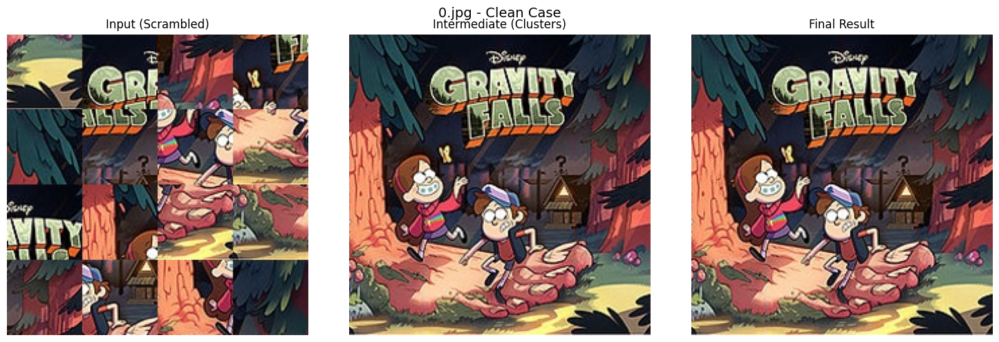

--------------------------------------------------
Processing: 109.jpg | Type: Clean Case


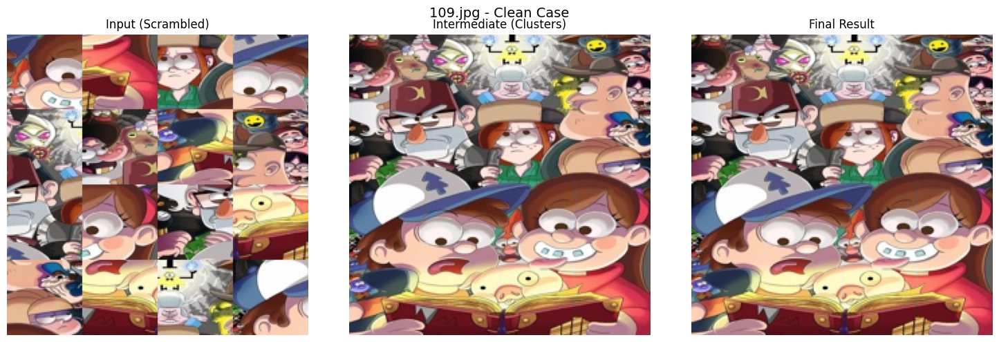

--------------------------------------------------
Processing: 109.jpg | Type: Challenging Case (Noisy)


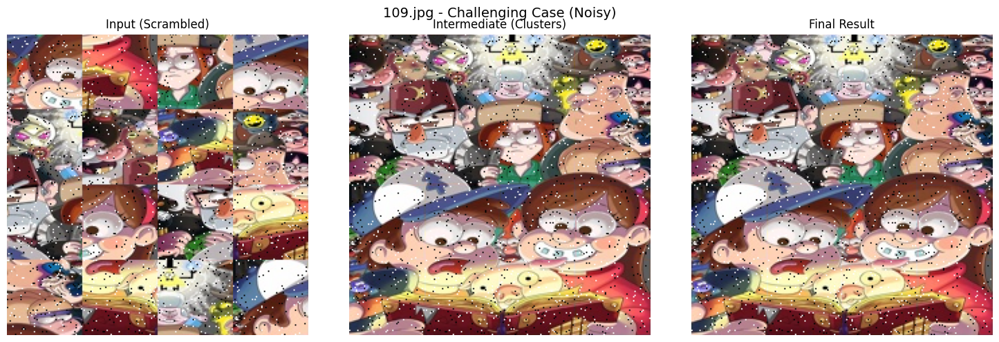

--------------------------------------------------


In [13]:
# =========================================================
# 1. SETUP & IMPORTS
# =========================================================
import cv2
import numpy as np
import glob
import os
import matplotlib.pyplot as plt
import random
from copy import deepcopy

# Mount Drive
if not os.path.exists('/content/drive'):
    from google.colab import drive
    drive.mount('/content/drive')

# PATH SETUP
base_path = "/content/drive/MyDrive/Gravity Falls/puzzle_4x4/"
GRID_SIZE = 4

# =========================================================
# 2. HELPER: NOISE GENERATOR (For "Challenging" Case)
# =========================================================
def add_noise(image, intensity=0.05):
    """
    Adds 'Salt and Pepper' noise to an image to make it challenging.
    intensity: Percentage of pixels to corrupt (0.05 = 5%)
    """
    noisy = image.copy()
    h, w, c = noisy.shape
    num_pixels = int(h * w * intensity)

    # Add White spots (Salt)
    for _ in range(num_pixels):
        y = random.randint(0, h-1)
        x = random.randint(0, w-1)
        noisy[y, x] = [255, 255, 255]

    # Add Black spots (Pepper)
    for _ in range(num_pixels):
        y = random.randint(0, h-1)
        x = random.randint(0, w-1)
        noisy[y, x] = [0, 0, 0]

    return noisy

# =========================================================
# 3. SOLVER WITH VISUALIZATION HOOKS
# =========================================================

class PuzzleGroup:
    def __init__(self, piece_id):
        self.placements = {(0, 0): piece_id}
        self.min_r, self.max_r = 0, 0
        self.min_c, self.max_c = 0, 0
        self.id = piece_id

    def size(self): return len(self.placements)

    def can_merge(self, other_group, offset_r, offset_c):
        new_min_r = min(self.min_r, other_group.min_r + offset_r)
        new_max_r = max(self.max_r, other_group.max_r + offset_r)
        new_min_c = min(self.min_c, other_group.min_c + offset_c)
        new_max_c = max(self.max_c, other_group.max_c + offset_c)

        if (new_max_r - new_min_r + 1) > GRID_SIZE: return False
        if (new_max_c - new_min_c + 1) > GRID_SIZE: return False

        for (r, c) in other_group.placements:
            if (r + offset_r, c + offset_c) in self.placements:
                return False
        return True

    def merge(self, other_group, offset_r, offset_c):
        for (r, c), pid in other_group.placements.items():
            self.placements[(r + offset_r, c + offset_c)] = pid
        self.min_r = min(self.min_r, other_group.min_r + offset_r)
        self.max_r = max(self.max_r, other_group.max_r + offset_r)
        self.min_c = min(self.min_c, other_group.min_c + offset_c)
        self.max_c = max(self.max_c, other_group.max_c + offset_c)

def render_current_state(groups, pieces, h_tile, w_tile):
    """
    Renders the current state of the puzzle, showing separated groups.
    """
    # Create a larger canvas to hold separated groups
    canvas_h = GRID_SIZE * h_tile
    canvas_w = GRID_SIZE * w_tile
    canvas = np.full((canvas_h, canvas_w, 3), 255, dtype=np.uint8) # White background

    # We simply render the largest group found so far
    # (In a real animation, we would show all groups floating,
    # but for simplicity, we show the main progress).

    if not groups: return canvas

    main_group = max(groups.values(), key=lambda g: g.size())

    for (r, c), pid in main_group.placements.items():
        final_r = r - main_group.min_r
        final_c = c - main_group.min_c
        if 0 <= final_r < GRID_SIZE and 0 <= final_c < GRID_SIZE:
            canvas[final_r*h_tile : (final_r+1)*h_tile, final_c*w_tile : (final_c+1)*w_tile] = pieces[pid]

    return canvas

def solve_with_history(pieces):
    """
    Solves the puzzle and returns [Initial, Intermediate, Final] images.
    """
    history = []
    h_tile, w_tile, _ = pieces[0].shape

    # Snapshot 1: Initial Scramble (Render piece 0..15 in grid order)
    scramble_canvas = np.zeros((GRID_SIZE*h_tile, GRID_SIZE*w_tile, 3), dtype=np.uint8)
    for i in range(min(len(pieces), 16)):
        r, c = divmod(i, GRID_SIZE)
        scramble_canvas[r*h_tile:(r+1)*h_tile, c*w_tile:(c+1)*w_tile] = pieces[i]
    history.append(("Input (Scrambled)", scramble_canvas))

    # --- LOGIC START ---
    lab_pieces = [cv2.cvtColor(p, cv2.COLOR_RGB2LAB).astype("float32") for p in pieces]

    # Calculate Smart Edges
    rights  = np.array([p[:, -1, :] for p in lab_pieces])
    lefts   = np.array([p[:, 0, :] for p in lab_pieces])
    bottoms = np.array([p[-1, :, :] for p in lab_pieces])
    tops    = np.array([p[0, :, :] for p in lab_pieces])

    H_cost = np.zeros((16, 16))
    V_cost = np.zeros((16, 16))

    # Variance for priority
    H_var = np.array([np.var(np.mean(rights[i], axis=1)) for i in range(16)])
    V_var = np.array([np.var(np.mean(bottoms[i], axis=1)) for i in range(16)])

    for i in range(16):
        for j in range(16):
            if i == j: H_cost[i,j] = V_cost[i,j] = float('inf'); continue
            H_cost[i,j] = np.sum((rights[i] - lefts[j])**2)
            V_cost[i,j] = np.sum((bottoms[i] - tops[j])**2)

    edges = []
    for u in range(16):
        for v in range(16):
            if u == v: continue

            # Best Buddy Logic
            best_h_fwd = np.argmin(H_cost[u, :])
            best_h_bwd = np.argmin(H_cost[:, v])
            is_buddy_h = (best_h_fwd == v) and (best_h_bwd == u)
            score_h = (-10000 - H_var[u]) if is_buddy_h else H_cost[u, v]
            edges.append((score_h, u, v, 0))

            best_v_fwd = np.argmin(V_cost[u, :])
            best_v_bwd = np.argmin(V_cost[:, v])
            is_buddy_v = (best_v_fwd == v) and (best_v_bwd == u)
            score_v = (-10000 - V_var[u]) if is_buddy_v else V_cost[u, v]
            edges.append((score_v, u, v, 1))

    edges.sort(key=lambda x: x[0])

    groups = {i: PuzzleGroup(i) for i in range(16)}
    group_lookup = {i: i for i in range(16)}

    # PHASE 1: STRICT MERGE
    for _, u, v, relation in edges:
        u_gid = group_lookup[u]
        v_gid = group_lookup[v]
        if u_gid == v_gid: continue

        group_u = groups[u_gid]
        group_v = groups[v_gid]

        u_loc = [k for k, val in group_u.placements.items() if val == u][0]
        v_loc = [k for k, val in group_v.placements.items() if val == v][0]

        if relation == 0: target_r, target_c = u_loc[0], u_loc[1] + 1
        else:             target_r, target_c = u_loc[0] + 1, u_loc[1]

        offset_r = target_r - v_loc[0]
        offset_c = target_c - v_loc[1]

        if group_u.can_merge(group_v, offset_r, offset_c):
            group_u.merge(group_v, offset_r, offset_c)
            for pid in group_v.placements.values():
                group_lookup[pid] = u_gid
            del groups[v_gid]

    # Snapshot 2: Intermediate Result (After Strict Phase)
    mid_canvas = render_current_state(groups, pieces, h_tile, w_tile)
    history.append(("Intermediate (Clusters)", mid_canvas))

    # PHASE 2: GAP FILLING
    while len(groups) > 1:
        best_score = float('inf')
        best_action = None
        g_ids = list(groups.keys())

        for i in range(len(g_ids)):
            for j in range(i+1, len(g_ids)):
                g1, g2 = groups[g_ids[i]], groups[g_ids[j]]
                for (r1, c1), p1 in g1.placements.items():
                    for (r2, c2), p2 in g2.placements.items():
                        moves = [
                            (H_cost[p1, p2], r1, c1+1, r2, c2),
                            (V_cost[p1, p2], r1+1, c1, r2, c2),
                            (H_cost[p2, p1], r1, c1-1, r2, c2),
                            (V_cost[p2, p1], r1-1, c1, r2, c2)
                        ]
                        for s, tr, tc, vr, vc in moves:
                            if s < best_score:
                                off_r, off_c = tr-vr, tc-vc
                                if g1.can_merge(g2, off_r, off_c):
                                    best_score = s
                                    best_action = (g1, g2, off_r, off_c, g_ids[j])

        if best_action:
            best_action[0].merge(best_action[1], best_action[2], best_action[3])
            del groups[best_action[4]]
        else: break

    # Snapshot 3: Final
    final_canvas = render_current_state(groups, pieces, h_tile, w_tile)
    history.append(("Final Result", final_canvas))

    return history

# =========================================================
# 4. SLICING HELPER
# =========================================================
def slice_image(image):
    h, w, _ = image.shape
    d_h, d_w = h//GRID_SIZE, w//GRID_SIZE
    pieces = []
    for r in range(GRID_SIZE):
        for c in range(GRID_SIZE):
            pieces.append(image[r*d_h:(r+1)*d_h, c*d_w:(c+1)*d_w])
    return pieces

# =========================================================
# 5. DEMO EXECUTION
# =========================================================
search_path = os.path.join(base_path, "*.jpg")
image_paths = sorted(glob.glob(search_path), key=lambda x: int(os.path.basename(x).split('.')[0]))

# Pick specific examples for the demo
if len(image_paths) >= 2:
    demo_indices = [0, -1] # First and Last image
else:
    demo_indices = [0]

print(f"--- JIGSAW SOLVER DEMO (4x4) ---\n")

for idx in demo_indices:
    path = image_paths[idx]
    filename = os.path.basename(path)

    # 1. LOAD & PREPARE
    original = cv2.imread(path)
    original = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)

    # Create Two Cases: CLEAN and NOISY
    cases = [("Clean Case", original)]

    # Only do noisy for the second image to show variety
    if idx == demo_indices[-1]:
        noisy_img = add_noise(original, intensity=0.02) # 2% Noise
        cases.append(("Challenging Case (Noisy)", noisy_img))

    for case_name, img_data in cases:
        print(f"Processing: {filename} | Type: {case_name}")

        # Slice & Shuffle
        pieces = slice_image(img_data)
        random.seed(idx)
        random.shuffle(pieces)

        # Solve with History
        steps = solve_with_history(pieces)

        # VISUALIZE
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        fig.suptitle(f"{filename} - {case_name}", fontsize=14)

        for ax, (title, img) in zip(axes, steps):
            ax.imshow(img)
            ax.set_title(title)
            ax.axis('off')

        plt.tight_layout()
        plt.show()
        print("-" * 50)